In [576]:
# ---------------------------------------------------------------------
# Imports
# ---------------------------------------------------------------------
import numpy as np
from mpi4py import MPI
from petsc4py import PETSc
import ufl
import pyvista
import imageio
from dolfinx import mesh, fem, la
from ufl import FacetNormal
from ufl import dot, grad, dx, ds, inner
import dolfinx.fem.petsc    
from IPython.display import Image, display

In [637]:
# ---------------------------------------------------------------------
# Define Dependent Variables
# ---------------------------------------------------------------------

#for intital conditon
initial_condition_spread = 100 #The larger this number the less spread out the initial conditions are

#for diffusion equation
diffusion_coefficient = 0.1 # base diffusion
diffusion_penalty_factor = .10 #The higher this number, the more diffusion occurs on flat surfaces, 

#for advection equation
velocity_coefficent = 2 
x_velocity =  -0.0 
y_velocity = -0.0

# for solving the function
time_step = 5e-4
final_time = 0.2
output_file_name = "advection_diffusion_spatial_variance.gif"

In [638]:
# ---------------------------------------------------------------------
# Define Mesh, trial and test fuction
# ---------------------------------------------------------------------
comm = MPI.COMM_WORLD
mesh_width, mesh_height = 64, 64
domain = mesh.create_unit_square(comm, mesh_width, mesh_height, mesh.CellType.triangle)
V = fem.functionspace(domain, ("Lagrange", 1))

u = ufl.TrialFunction(V)
v = ufl.TestFunction(V)

In [639]:
# ---------------------------------------------------------------------
# Define Evironment 
# ---------------------------------------------------------------------

# Equation to define environment height, creates a hump in the middle of the plane
def height_expr(x):
    func = (x[0] - 0.5)**2 + (x[1] - 0.5)**2
    return .5 * np.exp(-20*func)      

environment_height_function = fem.Function(V, name="environment_height")
environment_height_function.interpolate(height_expr)
environment_height_function.x.scatter_forward()

# Create and store the gradient of each element
W = fem.functionspace(domain, ("DG", 0, (domain.geometry.dim,))) 
topology_gradient = fem.Function(W, name="grad_topo")
topology_gradient_expr = fem.Expression(ufl.as_vector((ufl.Dx(environment_height_function, 0), ufl.Dx(environment_height_function, 1))), W.element.interpolation_points())
topology_gradient.interpolate(topology_gradient_expr)

In [640]:
# ---------------------------------------------------------------------
# Define spatially dependent diffusion coefficent and velocity
# ---------------------------------------------------------------------

# Diffusion Function
# Creat a function across the mesh to vary the diffusion by the gradient
diffusion_function = fem.Function(fem.functionspace(domain, ("DG", 0)))
slope_mag = np.linalg.norm(topology_gradient.x.array.reshape((-1,2)), axis=1)
diffusion_function.x.array[:] = diffusion_coefficient / (1.0 + diffusion_penalty_factor * slope_mag)

#Velocity Function
initial_velocity_vector = ufl.as_vector((x_velocity, y_velocity))
gradiant_vector = ufl.as_vector((ufl.Dx(environment_height_function, 0), ufl.Dx(environment_height_function, 1))) 
velocity_expression = fem.Expression(velocity_coefficent * gradiant_vector + initial_velocity_vector, W.element.interpolation_points())

velocity_function = fem.Function(W, name="v_total")
velocity_function.interpolate(velocity_expression)
velocity_function.x.scatter_forward()

In [641]:
# ---------------------------------------------------------------------
# Definie Initial conditions as a 2d Gaussian
# ---------------------------------------------------------------------
u_prev = fem.Function(V, name="u_prev")
dof_xy = V.tabulate_dof_coordinates()        # (ndofs, 2)
x_vals = dof_xy[:, 0]
y_vals = dof_xy[:, 1]

u_prev.x.array[:] =  np.exp(((x_vals - 0.5)**2 + (y_vals - 0.5)**2) * -initial_condition_spread) #2d Gaussian centerd at (0.5,0.5)
u_prev.x.scatter_forward()

In [642]:
# ---------------------------------------------------------------------
# Define Advection Diffusion Equation
# ---------------------------------------------------------------------

# Physical parameters
D  = dolfinx.fem.Constant(domain, diffusion_coefficient)
dt = dolfinx.fem.Constant(domain, time_step)
v0 = dolfinx.fem.Constant(domain, (x_velocity, y_velocity))

# Outward normal (for the boundary integral)
n = FacetNormal(domain)

# Weak Form of Advection Diffusion equation
a = (u * v + diffusion_function * dt * dot(grad(u), grad(v)) - dt * dot(velocity_function, grad(u)) * v) * dx

# add the boundary integral into a
a += dt * (dot(velocity_function, n) * u * v) * ds

# Build the right‐hand side form L(v)
L = (u_prev * v) * dx       

# Compile
a_form = dolfinx.fem.form(a)
L_form = dolfinx.fem.form(L)

In [643]:
# ---------------------------------------------------------------------
# Assemble the matrix
# ---------------------------------------------------------------------
A_mat  = dolfinx.fem.petsc.assemble_matrix((a_form), bcs=[])    
A_mat.assemble()
b_vec  = dolfinx.fem.petsc.assemble_vector((L_form))              

In [644]:
# ---------------------------------------------------------------------
# Define Solver, uses SQR
# ---------------------------------------------------------------------
ksp = PETSc.KSP().create(comm)
ksp.setOperators(A_mat)                    
ksp.setType(PETSc.KSP.Type.CG)
ksp.getPC().setType(PETSc.PC.Type.SOR)

In [645]:
# ---------------------------------------------------------------------
# Solve equation and write screenshots into a gif
# ---------------------------------------------------------------------

# Create plotter for solutions
topo, cells, xyz = dolfinx.plot.vtk_mesh(V)
xyz_warped = xyz.copy()
xyz_warped[:, 2] = environment_height_function.x.array      # height field
grid = pyvista.UnstructuredGrid(topo, cells, xyz_warped)
grid.point_data["u"] = u_prev.x.array
grid.set_active_scalars("u")
grid.warp_by_scalar(scalars= "u", normal = (0,0,1))
pl = pyvista.Plotter(off_screen=True, window_size=(1000,1000))
pl.view_isometric()

solution_screenshots = [] 

# Solve the system of equations
u_curr   = fem.Function(V, name="u_curr")
n_steps  = int(final_time / time_step)

for step in range(1, n_steps + 1):
    with b_vec.localForm() as loc:
        loc.set(0.0)

    dolfinx.fem.petsc.assemble_vector(b_vec, L_form)
    b_vec.ghostUpdate(addv=PETSc.InsertMode.ADD_VALUES, mode =PETSc.ScatterMode.REVERSE)

    ksp.solve(b_vec, u_curr.x.petsc_vec)      
    u_curr.x.scatter_forward()
    u_prev.x.array[:] = u_curr.x.array
     
    
    if step % 2 == 0:
        pl.clear()
        grid.point_data["u"] = u_curr.x.array
        grid.set_active_scalars("u")
        pl.add_mesh(grid, show_edges=True, clim = [0, .5])
       
        mesh_screenshot = pl.screenshot()
        solution_screenshots.append(mesh_screenshot)

    if comm.rank == 0 and step % 10 == 0:
        print(f"step {step:3d}/{n_steps},   t = {step*time_step:6.4f}")

pl.close()

# 8. Write final solution
if comm.rank == 0:
    with imageio.get_writer(output_file_name, mode = "I", fps=10) as writer:
        for fn in solution_screenshots:
            writer.append_data(fn)
    print("finsihed writing " + output_file_name)



step  10/400,   t = 0.0050
step  20/400,   t = 0.0100
step  30/400,   t = 0.0150
step  40/400,   t = 0.0200
step  50/400,   t = 0.0250
step  60/400,   t = 0.0300
step  70/400,   t = 0.0350
step  80/400,   t = 0.0400
step  90/400,   t = 0.0450
step 100/400,   t = 0.0500
step 110/400,   t = 0.0550
step 120/400,   t = 0.0600
step 130/400,   t = 0.0650
step 140/400,   t = 0.0700
step 150/400,   t = 0.0750
step 160/400,   t = 0.0800
step 170/400,   t = 0.0850
step 180/400,   t = 0.0900
step 190/400,   t = 0.0950
step 200/400,   t = 0.1000
step 210/400,   t = 0.1050
step 220/400,   t = 0.1100
step 230/400,   t = 0.1150
step 240/400,   t = 0.1200
step 250/400,   t = 0.1250
step 260/400,   t = 0.1300
step 270/400,   t = 0.1350
step 280/400,   t = 0.1400
step 290/400,   t = 0.1450
step 300/400,   t = 0.1500
step 310/400,   t = 0.1550
step 320/400,   t = 0.1600
step 330/400,   t = 0.1650
step 340/400,   t = 0.1700
step 350/400,   t = 0.1750
step 360/400,   t = 0.1800
step 370/400,   t = 0.1850
s

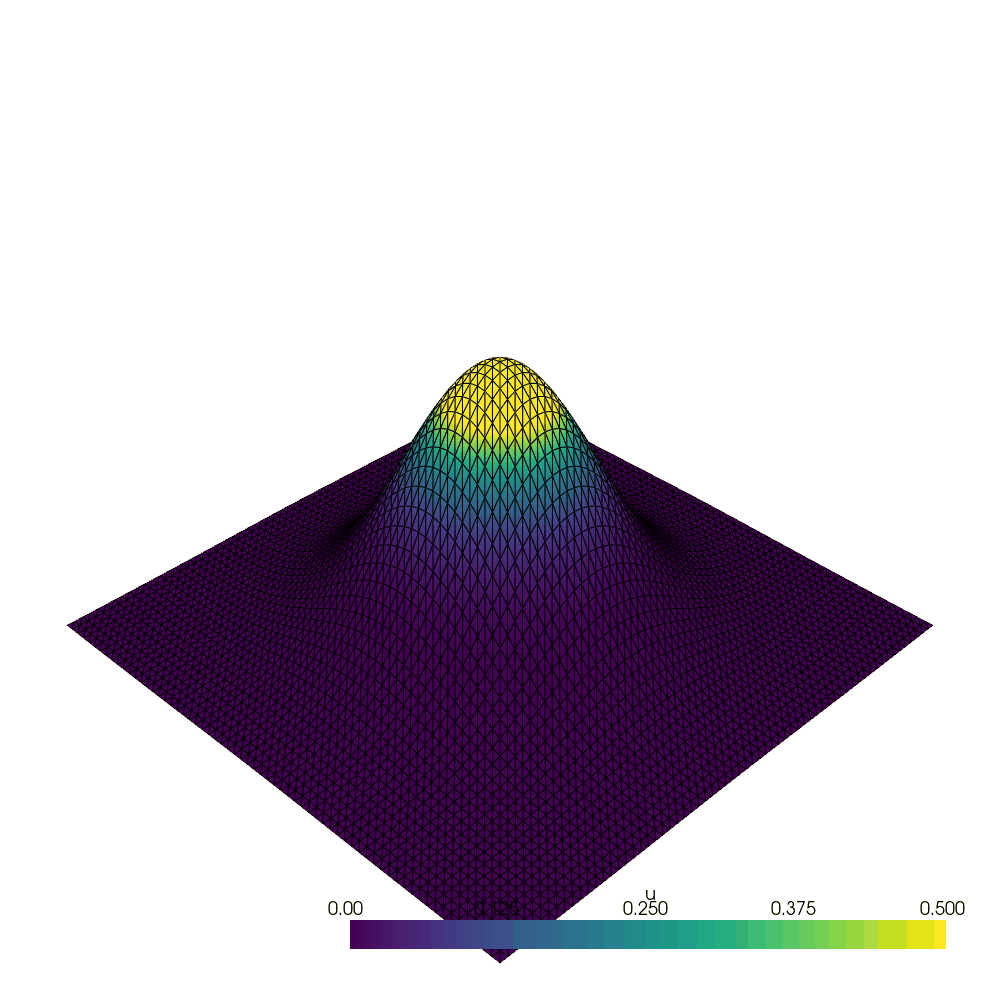

In [ ]:
# ---------------------------------------------------------------------
# Display answer
# --------------------------------------------------------------------
display(Image(filename = output_file_name))